In [1]:
! nvidia-smi -L

GPU 0: NVIDIA GeForce RTX 3060 Laptop GPU (UUID: GPU-53a27a06-233d-07b9-fc18-a603ac868ab1)


In [2]:
%%time

! pip install ultralytics==8.1.29 -qq

CPU times: total: 0 ns
Wall time: 1.31 s


In [3]:
import warnings
warnings.filterwarnings("ignore")

import os
import re
import glob
import yaml
import subprocess

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_palette('Set3')

import IPython.display as display
from IPython.display import Video

from PIL import Image
import cv2

import torch

from ultralytics import YOLO

In [4]:
import ultralytics
print(ultralytics.__version__)

8.1.29


CFG

In [ ]:
import numpy as np

class CFG:
    ### Inference: Use any pretrained or custom model
    # Pretrained YOLOv8 model weights or custom weights
    WEIGHTS = r"C:\Learning\AIPC\YoloV8\data\runs\detect\yolov8s_ppe_css_50_epochs\weights\best.pt"

    # Detection confidence threshold
    CONFIDENCE = 0.60
    CONFIDENCE_INT = int(round(CONFIDENCE * 100, 0))  # Confidence as percentage

    # Detect all classes (0–9)
    CLASSES_TO_DETECT = list(range(10))  # [0, 1, 2, ..., 9]
    CLASS_NAMES = [
        "Hardhat", "Mask", "NO-Hardhat", "NO-Mask", 
        "NO-Safety Vest", "Person", "Safety Cone", 
        "Safety Vest", "machinery", "vehicle"
    ]

    # Region of Interest (ROI): Vertices defining a polygon
    # Useful for filtering the detection in specific regions.
    VERTICES_POLYGON = np.array([
        [200, 720], 
        [0, 700], 
        [500, 620], 
        [990, 690], 
        [820, 720]
    ])

    # Experiment name for logging or output file organization
    EXP_NAME = 'ppe'

    ### Input File: Video or Image
    VID_001 = r"C:\Learning\AIPC\YoloV8\redZone\css-data\example_video.mp4"  # Example video
    PATH_TO_INFER_ON = VID_001  # Filepath for inference
    EXT = PATH_TO_INFER_ON.split('.')[-1]  # File extension (e.g., mp4)
    FILENAME_TO_INFER_ON = PATH_TO_INFER_ON.split('/')[-1].split('.')[0]  # Filename without extension

    ### Paths
    ROOT_DIR = '/kaggle/input/video-example-for-ppe-red-zone/'  # Dataset root (if needed)
    OUTPUT_DIR = './'  # Directory for saving outputs


In [7]:
glob.glob(CFG.ROOT_DIR + '*')

[]

In [8]:
def get_image_properties(image):
    if isinstance(image, str):
        # If image is a file path, read the image
        img = cv2.imread(image)
        if img is None:
            raise ValueError("Could not read image file")
    elif isinstance(image, np.ndarray):
        # If image is already a NumPy array, use it directly
        img = image
    else:
        raise ValueError("Input must be a file path or a NumPy array")

    # Get image properties
    properties = {
        "width": img.shape[1],
        "height": img.shape[0],
        "channels": img.shape[2] if len(img.shape) == 3 else 1,
        "dtype": img.dtype,
    }

    return properties

In [9]:
def display_image(image, print_info = True, hide_axis = False):
    if isinstance(image, str):  # Check if it's a file path
        img = Image.open(image)
        plt.imshow(img)
    elif isinstance(image, np.ndarray):  # Check if it's a NumPy array
        image = image[..., ::-1]  # BGR to RGB
        img = Image.fromarray(image)
        plt.imshow(img)
    else:
        raise ValueError("Unsupported image format")

    if print_info:
        print('Type: ', type(img), '\n')
        print('Shape: ', np.array(img).shape, '\n')
        
    if hide_axis:
        plt.axis('off')
        
    plt.show()

In [10]:
def get_video_properties(video_path):
    # Open the video file
    cap = cv2.VideoCapture(video_path)

    # Check if the video file is opened successfully
    if not cap.isOpened():
        raise ValueError("Could not open video file")

    # Get video properties
    properties = {
        "fps": int(cap.get(cv2.CAP_PROP_FPS)),
        "frame_count": int(cap.get(cv2.CAP_PROP_FRAME_COUNT)),
        "duration_seconds": int( cap.get(cv2.CAP_PROP_FRAME_COUNT) / cap.get(cv2.CAP_PROP_FPS) ),
        "width": int(cap.get(cv2.CAP_PROP_FRAME_WIDTH)),
        "height": int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT)),
        "codec": int(cap.get(cv2.CAP_PROP_FOURCC)),
    }

    # Release the video capture object
    cap.release()

    return properties

In [11]:
### testing function
video_properties = get_video_properties(CFG.VID_001)
video_properties

{'fps': 29,
 'frame_count': 697,
 'duration_seconds': 24,
 'width': 1280,
 'height': 720,
 'codec': 877677894}

In [12]:
import shutil

# Check if ffmpeg is available in PATH
ffmpeg_path = shutil.which("ffmpeg")
if ffmpeg_path:
    print(f"FFmpeg is installed and found at {ffmpeg_path}")
else:
    print("FFmpeg is not found in PATH.")


FFmpeg is installed and found at C:\ffmpeg\bin\ffmpeg.EXE


In [13]:
OUT_VIDEO_NAME = './video_to_infer.mp4'

subprocess.run(
    [
        "ffmpeg",  "-i", CFG.PATH_TO_INFER_ON, "-crf",
        "18", "-preset", "veryfast", "-hide_banner", "-loglevel",
        "error", "-vcodec", "libx264", OUT_VIDEO_NAME
    ]
)

Video(data=OUT_VIDEO_NAME, embed=True, height=int(video_properties['height'] * 0.5), width=int(video_properties['width'] * 0.5))

Adjust Red Zone

In [14]:
print('File path to make inference on: ', CFG.PATH_TO_INFER_ON)
print('File name to make inference on: ', CFG.FILENAME_TO_INFER_ON)

File path to make inference on:  C:\Learning\AIPC\YoloV8\redZone\css-data\example_video.mp4
File name to make inference on:  C:\Learning\AIPC\YoloV8\redZone\css-data\example_video


In [ ]:
# reads a video, extracts the first frame, draws a polygon (ROI), creates a semi-transparent overlay of the polygon on the frame, and blends the overlay with the original frame to highlight the region.


cap = cv2.VideoCapture(CFG.PATH_TO_INFER_ON)

if not cap.isOpened():
    print("Error: Could not open video file.")
else:
    # Read the first frame
    ret, frame_test = cap.read()
    cap.release()

vertices_polygon = np.array([[200,720], [0,700], [500,620], [990,690], [820,720]]) # manually adjusted

# Draw the polygon outline on frame_test with a color (0, 0, 128) (dark red) and line thickness of 4.
cv2.polylines(frame_test, [vertices_polygon.reshape(-1, 1, 2)], True, (0, 0, 128), 4)

mod = frame_test.copy()
overlay = cv2.fillPoly(mod, pts = [vertices_polygon], color=(0, 0, 128))
background = frame_test.copy()

# Blends background and overlay with weights of 60% and 40%, respectively.
# The result is stored in frame_test, with a slight enhancement (gamma = 0.1).

frame_test = cv2.addWeighted(
    src1 = background, # fisrt image
    alpha = 0.6, # first image weight
    src2 = overlay, # second image
    beta = 0.4, # second image weight
    gamma = 0.1, # scalar factor
    dst = overlay # output array shape
)

Type:  <class 'PIL.Image.Image'> 

Shape:  (720, 1280, 3) 



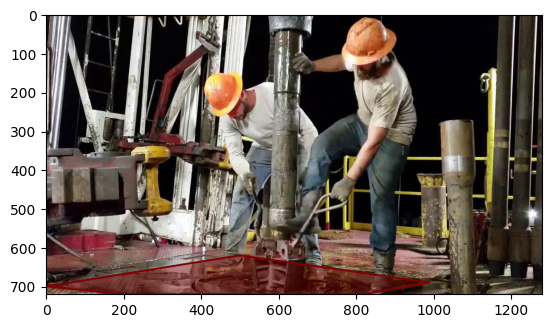

In [16]:
display_image(frame_test)

In [17]:
img_properties = get_image_properties(frame_test)
img_properties

{'width': 1280, 'height': 720, 'channels': 3, 'dtype': dtype('uint8')}

Model

In [18]:
model = YOLO(CFG.WEIGHTS)

In [19]:
print('Device: ', model.device)

Device:  cpu


In [20]:
if torch.cuda.is_available():
    model.to('cuda:0')
else:
    print("CUDA device is not available. Running on CPU.")

In [21]:
print('Device: ', model.device)
print('Weights: ', CFG.WEIGHTS)

Device:  cuda:0
Weights:  C:\Learning\AIPC\YoloV8\data\runs\detect\yolov8s_ppe_css_50_epochs\weights\best.pt


In [22]:
model.names

{0: 'Hardhat',
 1: 'Mask',
 2: 'NO-Hardhat',
 3: 'NO-Mask',
 4: 'NO-Safety Vest',
 5: 'Person',
 6: 'Safety Cone',
 7: 'Safety Vest',
 8: 'machinery',
 9: 'vehicle'}

Inference

In [23]:
# Perform inference
results = model.predict(
    source=CFG.PATH_TO_INFER_ON, 
    save=True,  # This will automatically save the video with detections
    show=False, 
    classes=CFG.CLASSES_TO_DETECT,
    conf=CFG.CONFIDENCE, 
    device="cuda:0"
)

# Check the location of the saved output video
output_video_path = results[0].path  # Access the path of the saved video
print("Output video saved at:", output_video_path)




WARNING ⚠️ inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/697) C:\Learning\AIPC\YoloV8\redZone\css-data\example_video.mp4: 384x640 2 NO-Safety Vests, 2 Persons, 70.2ms
video 1/1 (frame 2/697) C:\Learning\AIPC\YoloV8\redZone\css-data\example_video.mp4: 384x640 3 NO-Safety Vests, 2 Persons, 9.6ms
video 1/1 (frame 3/697) C:\Learning\AIPC\YoloV8\redZone\css-data\example_video.mp4: 384x640 3 NO-Safety Vests, 2 Persons, 8.5ms
video 1/1 (frame 4/697) C:\Learning\AIPC\YoloV8\redZone\css-data\exampl

Raw inference video

In [ ]:
# Command Explanation
# "ffmpeg":

# Invokes the FFmpeg command-line tool.
# -i RAW_INFERENCE_VIDEO:

# Specifies the input video file.
# -crf 18:

# Constant Rate Factor (CRF) for encoding quality.
# Lower CRF (like 18) results in higher quality and larger file sizes.
# -preset veryfast:

# Optimizes the trade-off between encoding speed and compression efficiency.
# Faster presets (e.g., veryfast) are less compressed but quicker.
# -hide_banner:

# Suppresses FFmpeg's startup banner output.
# -loglevel error:

# Limits output to only error messages.
# -vcodec libx264:

# Specifies the video codec for MP4 encoding (libx264 is widely supported).
# OUT_VIDEO_NAME:

# The output file where the processed video is saved.


RAW_INFERENCE_VIDEO = glob.glob(r"C:\Learning\AIPC\YoloV8\redZone\runs\detect\predict\example_video*")[0]
OUT_VIDEO_NAME = './raw_inference.mp4'

subprocess.run(
    [
        "ffmpeg",  "-i", RAW_INFERENCE_VIDEO, "-crf",
        "18", "-preset", "veryfast", "-hide_banner", "-loglevel",
        "error", "-vcodec", "libx264", OUT_VIDEO_NAME
    ]
)

Video(data=OUT_VIDEO_NAME, embed=True, height=int(video_properties['height'] * 0.5), width=int(video_properties['width'] * 0.5))

NameError: name 'glob' is not defined

In [25]:
raw_inference_video_properties = get_video_properties(RAW_INFERENCE_VIDEO)
raw_inference_video_properties

{'fps': 29,
 'frame_count': 697,
 'duration_seconds': 24,
 'width': 1280,
 'height': 720,
 'codec': 846622071}

Get predictions

In [26]:
def get_predictions_df_for_videos(run = '', model = model, EXP_NAME = CFG.EXP_NAME, video_info = video_properties, save_df = True):
  df = pd.DataFrame()

  root = f'./runs/detect/predict{run}/labels/'
  pieces = sorted([i for i in os.listdir(root)])

  ### iterate over txt files (there is one for each frame in the video)
  for i, frame_txt in enumerate([i for i in pieces]):

    df = pd.read_csv(root + frame_txt, sep=" ", header=None) # read txt file as dataframe
    df.columns = ["class", "x_center", "y_center", "width", "height", "confidence"] # name columns (detection task)

    ### create column 'frame'
    frame_number = re.findall(r'\d+', frame_txt)[-1] # find frame in each txt filename
    df['frame'] = [int(frame_number) for i in range(len(df))]

    if i == 0:
      df_concat = df
    else:
      df_concat = pd.concat([df_concat, df], axis=0).reset_index(drop=True)

  ### create 4 new columns (coordinates converted into pixels): Calculate bounding box coordinates
  df_concat['x_min'] = (df_concat['x_center'] * video_info['width']) - ((df_concat['width'] * video_info['width'])/2)
  df_concat['x_max'] = (df_concat['x_center'] * video_info['width']) + ((df_concat['width'] * video_info['width'])/2)
  df_concat['y_min'] = (df_concat['y_center'] * video_info['height']) - ((df_concat['height'] * video_info['height'])/2)
  df_concat['y_max'] = (df_concat['y_center'] * video_info['height']) + ((df_concat['height'] * video_info['height']/2))

  ### create 2 new columns: height and width in pixels: will be used to filter out bad predictions (false positives)
  df_concat['width_px'] = (df_concat['width'] * video_info['width']).round(0).astype(int)
  df_concat['height_px'] = (df_concat['height'] * video_info['height']).round(0).astype(int)

  ### sort by frame
  df_concat = df_concat.sort_values(by='frame', ascending=True).reset_index(drop=True)

  ### add column 'class_name' and rearrange order
  df_concat['class_name'] = df_concat['class'].map(model.names)
  other_cols = [col for col in df_concat.columns.to_list() if col not in ['frame', 'class_name', 'class', 'confidence' ]]
  new_order = ['frame', 'class_name', 'class', 'confidence'] + other_cols
  df_concat = df_concat[new_order]

  ### export detections df
  if save_df:
    df_concat.to_csv(CFG.OUTPUT_DIR + f'detections_{CFG.EXP_NAME}_c{CFG.CONFIDENCE_INT}.csv', index=False)

  return df_concat

In [27]:
out_df = get_predictions_df_for_videos(
    run = '',
    model = model,
    EXP_NAME = CFG.EXP_NAME,
    video_info = video_properties,
    save_df = False
)

out_df

FileNotFoundError: [WinError 3] The system cannot find the path specified: './runs/detect/predict/labels/'

Post-process predictions

In [34]:
def post_process_predictions_df(predictions_df, video_info = video_properties, EXP_NAME = CFG.EXP_NAME, save_df = True):

  df = predictions_df.copy()

  min_person_height = 250
  max_person_width = 620

  img_width = video_properties['width']
  img_height = video_properties['height']

  ### filter out False Positives based on new columns
  df_false_positives1 = df[ (df['height_px'] <= min_person_height) & (df['class_name'] == 'Person') ]
  df_false_positives2 = df[ (df['width_px'] >= max_person_width) & (df['class_name'] == 'Person') ]
  df_false_positives = pd.concat([df_false_positives1, df_false_positives2], axis=0)
  merged = df.merge(df_false_positives, how='left', indicator=True)
  df = merged[merged['_merge'] == 'left_only']
  df = df.drop('_merge', axis=1)
  df = df.reset_index(drop=True)
    
  print('out_df (raw detections) shape: ', out_df.shape)
  print('df_false_positives1: ', df_false_positives1.shape)
  print('df_false_positives2: ', df_false_positives2.shape)
  print('pp_df (post-processed detections) shape: ', df.shape, '\n')    

  ### export detections df
  if save_df:
    df.to_csv(CFG.OUTPUT_DIR + f'detections_{CFG.EXP_NAME}_c{CFG.CONFIDENCE_INT}.csv', index=False)

  return df

In [35]:
pp_df = post_process_predictions_df(
    out_df,
    video_info = video_properties,
    EXP_NAME = CFG.EXP_NAME,
    save_df = False
)

pp_df

out_df (raw detections) shape:  (8, 14)
df_false_positives1:  (0, 14)
df_false_positives2:  (0, 14)
pp_df (post-processed detections) shape:  (8, 14) 



,frame,class_name,class,confidence,x_center,y_center,width,height,x_min,x_max,y_min,y_max,width_px,height_px
0,6891,Safety Vest,7,0.925263,0.348622,0.790858,0.401541,0.417718,189.249920,703.222400,419.03928,719.79624,514,301
1,6891,Safety Cone,6,0.569300,0.962918,0.354979,0.073616,0.132555,1185.420800,1279.649280,207.86508,303.30468,94,95
2,6891,Safety Vest,7,0.444880,0.275872,0.283631,0.548262,0.565179,2.228480,704.003840,0.74988,407.67876,702,407
3,6891,Safety Vest,7,0.347114,0.079198,0.775597,0.157994,0.260485,0.257024,202.489344,464.65524,652.20444,202,188
4,6891,Safety Vest,7,0.925263,0.348622,0.790858,0.401541,0.417718,189.249920,703.222400,419.03928,719.79624,514,301
5,6891,Safety Cone,6,0.569300,0.962918,0.354979,0.073616,0.132555,1185.420800,1279.649280,207.86508,303.30468,94,95
6,6891,Safety Vest,7,0.444880,0.275872,0.283631,0.548262,0.565179,2.228480,704.003840,0.74988,407.67876,702,407
7,6891,Safety Vest,7,0.347114,0.079198,0.775597,0.157994,0.260485,0.257024,202.489344,464.65524,652.20444,202,188


Detections statistics

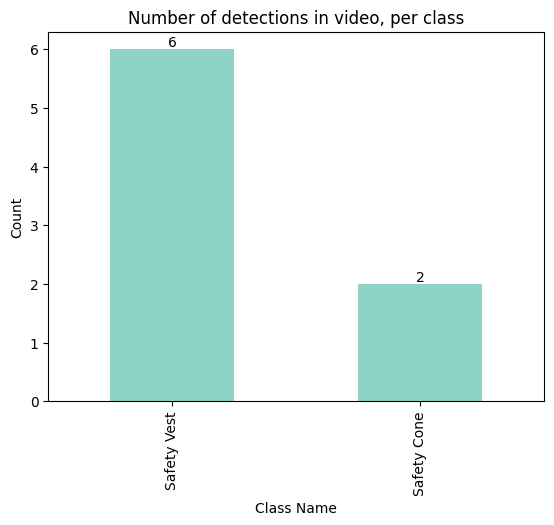

In [36]:
ax = pp_df['class_name'].value_counts().plot(kind='bar')

for p in ax.patches:
    ax.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='bottom')

plt.xlabel('Class Name')
plt.ylabel('Count')
plt.title('Number of detections in video, per class')
plt.show()

In [37]:
### median confidence for each class
### this can help tuning the confidence threshold
pp_df.groupby('class_name').confidence.median().round(3).sort_values(ascending=False)

class_name
Safety Cone    0.569
Safety Vest    0.445
Name: confidence, dtype: float64

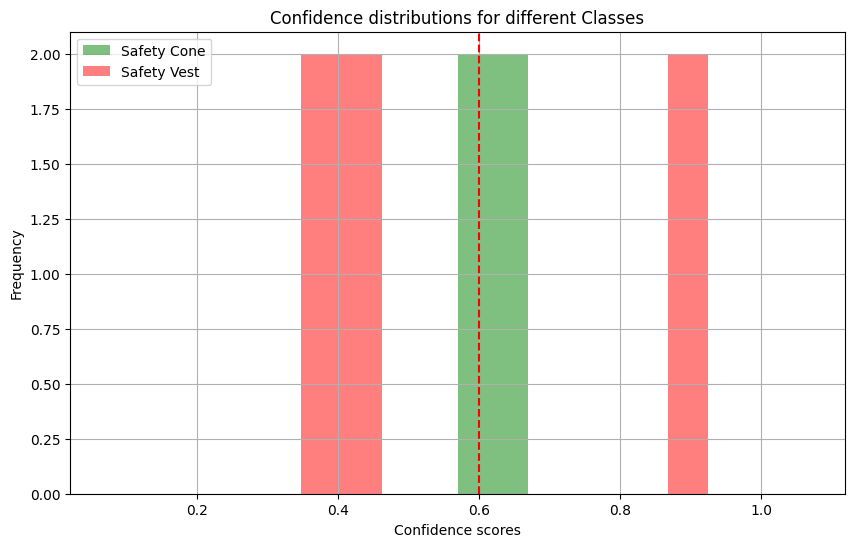

In [38]:
### distribution of confidence scores for each class
grouped = pp_df.groupby('class_name')

colors = ['green', 'red', 'pink', 'blue', 'lime']

plt.figure(figsize=(10, 6))

for i, (group_name, group_data) in enumerate(grouped):
    plt.hist(group_data['confidence'], bins=10, alpha=0.5, label=group_name, color=colors[i])

plt.xlabel('Confidence scores')
plt.ylabel('Frequency')
plt.title('Confidence distributions for different Classes')
plt.axvline(x=CFG.CONFIDENCE, linestyle='dashed', color='red')
plt.legend()
plt.grid(True)
plt.show()

Red Zone

In [39]:
def count_people_in_red_zone(frame_number, img, detections_dataframe, vertices=CFG.VERTICES_POLYGON):
    '''
    For a given frame (img) of the video, count how many people are in and out of the Red Zone.
    Check position in/out of the Red Zone only for Person class. Don't check other classes.

    Args:
    - frame_number: The frame number to process.
    - img: The frame image.
    - detections_dataframe: DataFrame containing detection information for all frames.
    - vertices: List of vertices defining the Red Zone polygon.

    Returns:
    - total_person_count: Total number of people in the frame.
    - count_person_in_roi: Number of people inside the Red Zone.
    - combined_df: Combined DataFrame with additional columns indicating if each person is in the Red Zone.
    '''

    count_person_in_roi = 0
    count_person_out_roi = 0

    frame_data = detections_dataframe[detections_dataframe['frame'] == frame_number].copy()

    if not frame_data.empty:
        frame_data['is_person_in_roi'] = 0  # Create a new column

        for i, row in frame_data.iterrows():
            if row['class_name'] == 'Person':
                foot_1 = (row['x_min'], row['y_max'])
                foot_2 = (row['x_max'], row['y_max'])

                # Draw little circles on each foot (orange)
                cv2.circle(img, np.array(foot_1).astype(int), 3, (0, 165, 255), -1)
                cv2.circle(img, np.array(foot_2).astype(int), 3, (0, 165, 255), -1)

                # Check if the foot is inside the polygon
                inside1 = cv2.pointPolygonTest(np.array([vertices]), foot_1, False)
                inside2 = cv2.pointPolygonTest(np.array([vertices]), foot_2, False)

                # 1: inside; 0: on border; -1: outside
                if inside1 == 1 or inside2 == 1:
                    count_person_in_roi += 1
                    frame_data.at[i, 'is_person_in_roi'] = 1
                else:
                    count_person_out_roi += 1

        # Calculate the total number of people in the frame
        total_person_count = len(frame_data[frame_data['class_name'] == 'Person'])

        # Create columns in the output DataFrame
        frame_data['person_count_in_roi'] = count_person_in_roi
        frame_data['person_count_out_roi'] = count_person_out_roi

        # Fill missing values with 0
        combined_df = frame_data.fillna(0)

        return total_person_count, count_person_in_roi, combined_df

    else:
        return 0, 0, frame_data

Draw

In [40]:
def draw_bounding_boxes_and_red_zone(df_coords, img, vertices = CFG.VERTICES_POLYGON, thickness=4, show_mask=True):
    '''
    Draw bounding boxes based on coordinates df, and set bbox colors.
    Draw Red Zone based on CFG.

    df_coords: detections dataframe produced by Yolo, already post-processed and then treated in red_zone_pipeline
    img: frame on which the bounding boxes (coordinates in df_coords) will be drawn
    '''

    ### person post-processing
    person_df = df_coords[df_coords['class_name'] == 'Person'].reset_index(drop=True)
    for i, person_detected in person_df.iterrows():

        # top left corner of rectangle
        start_point = ( int(person_detected['x_min']), int(person_detected['y_max']) )

        # bottom right corner of rectangle
        end_point = ( int(person_detected['x_max']), int(person_detected['y_min']) )

        if person_detected['is_person_in_roi'] == 1:
            cv2.rectangle(img, start_point, end_point, (0,0,128), thickness) # BGR maroon: in danger
        else:
            cv2.rectangle(img, start_point, end_point, (255,191,0), thickness) # BGR deepskyblue: not in danger

    ### Hardhat post-processing
    hardhat_df = df_coords[df_coords['class_name'] == 'Hardhat'].reset_index(drop=True)
    for i, hardhat_detected in hardhat_df.iterrows():

        # top left corner of rectangle
        start_point = ( int(hardhat_detected['x_min']), int(hardhat_detected['y_max']) )

        # bottom right corner of rectangle
        end_point = ( int(hardhat_detected['x_max']), int(hardhat_detected['y_min']) )

        cv2.rectangle(img, start_point, end_point, (0,128,0), thickness) # BGR, green

    ### Safety-Vest post-processing
    safety_vest_df = df_coords[df_coords['class_name'] == 'Safety Vest'].reset_index(drop=True)
    for i, safety_vest_detected in safety_vest_df.iterrows():

        # top left corner of rectangle
        start_point = ( int(safety_vest_detected['x_min']), int(safety_vest_detected['y_max']) )

        # bottom right corner of rectangle
        end_point = ( int(safety_vest_detected['x_max']), int(safety_vest_detected['y_min']) )

        cv2.rectangle(img, start_point, end_point, (0,255,0), thickness) # BGR, lime

    ### NO-Hardhat and NO-Safety-Vest post-processing
    no_PPE_df = df_coords[df_coords['class_name'].isin(['NO-Hardhat', 'NO-Safety Vest'])].reset_index(drop=True)
    for i, no_PPE_detected in no_PPE_df.iterrows():

        # top left corner of rectangle
        start_point = ( int(no_PPE_detected['x_min']), int(no_PPE_detected['y_max']) )

        # bottom right corner of rectangle
        end_point = ( int(no_PPE_detected['x_max']), int(no_PPE_detected['y_min']) )

        cv2.rectangle(img, start_point, end_point, (0,255,255), thickness) # BGR, yellow

    ### show mask (Red Zone)
    if show_mask:
        cv2.polylines(img, [vertices.reshape(-1,1,2)], True, (0,0,128), 4) # maroon

        mod = img.copy()
        overlay = cv2.fillPoly(mod, pts = [vertices], color=(0,0,128)) # maroon
        background = img.copy()

        img = cv2.addWeighted(
            src1 = background, # first image
            alpha = 0.6, # first image weight
            src2 = overlay, # second image
            beta = 0.4, # second image weight
            gamma = 0.1, # scalar factor
            dst = overlay # output array shape
        )    

    return img

Annotate

In [41]:
%%time
cap = cv2.VideoCapture(CFG.PATH_TO_INFER_ON)

save_exp = True
log = False

### Parameters to save video
if save_exp:
    ### save path and config for saving
    save_path_video = f'{CFG.OUTPUT_DIR}red_zone_det_vid_c{CFG.CONFIDENCE_INT}_{CFG.EXP_NAME}_{CFG.FILENAME_TO_INFER_ON}_pp.mp4'

    out = cv2.VideoWriter(
        save_path_video,
        cv2.VideoWriter_fourcc(*'XVID'),
        video_properties['fps'],
        (video_properties['width'], video_properties['height'])
    )

### create timestamp dataframe from frames dataframe
frame_count = video_properties['frame_count']
fps = video_properties['fps']
print('N frames: ', int(frame_count), '| FPS: ', int(fps))
list_timestamps = [second for second in range(int(frame_count/fps))] # list of timestamps
complete_frame_df = pd.DataFrame() # initialize frame_df

frame_number = 0
outputs_list = []

while cap.isOpened():
    frame_exists, frame = cap.read()

    ### get Timestamp (ts) to create timestamp_df
    ts = int(cap.get(cv2.CAP_PROP_POS_MSEC)) # Current position of the video file in milliseconds
    if log:
        print("Frame: " + str(frame_number) + "timestamp is: ", str(round(ts,2)))

    if not frame_exists:
        print("\nCan't receive frame (stream end?). Exiting...\n")
        break

    ### Count People in Red Zone
    count_person, count_person_roi, frame_df = count_people_in_red_zone(
        frame_number = frame_number,
        img = frame,
        detections_dataframe = pp_df,
        vertices = CFG.VERTICES_POLYGON
    )

    ### store results
    outputs_list.append([ts, frame_number, count_person, count_person_roi])
    complete_frame_df = pd.concat([complete_frame_df, frame_df], axis=0) # update (concat frames)


    ### Aggregate risk detections by seconds to create timestamp_df
    if int(ts/1000) in list_timestamps:
        idx = list_timestamps.index(int(ts/1000))

        ### get the max value of number of people detected on last second
        if idx == 0: # idx = 0 : first frame
            count_person_roi_agg = count_person_roi
        else: # idx > 0
            lower_cut = int(fps * list_timestamps[idx-1])
            upper_cut = int(fps * list_timestamps[idx])
            output_chunk_list = np.array(outputs_list[lower_cut:upper_cut])
            count_person_roi_agg = int(output_chunk_list[:,3].max()) # 3: count_person_roi output


    ### draw bounding boxes and red zone
    frame = draw_bounding_boxes_and_red_zone(
        df_coords = frame_df,
        img = frame,
        vertices = CFG.VERTICES_POLYGON,
        thickness = 4,
        show_mask = True,
    )

    ### print Danger
    h, w, c = frame.shape
    if count_person_roi_agg:
        cv2.putText(
            img = frame,
            text = f'Danger: {count_person_roi_agg}',
            org = ( w - (int(w/3)), h - (h - int(h/6)) ), # bottom-left corner of the text
            fontFace = cv2.FONT_HERSHEY_PLAIN,
            fontScale = 3, # 3,
            color = (0,0,128), # maroon
            thickness = 3
        )
    else:
        cv2.putText(
            img = frame,
            text = f'Danger: {count_person_roi_agg}',
            org = ( w - (int(w/3)), h - (h - int(h/6)) ), # bottom-left corner of the text
            fontFace = cv2.FONT_HERSHEY_PLAIN,
            fontScale = 3, # 3,
            color = (255,191,0), # deepskyblue
            thickness = 3
        )


    ### save frame with detections post-processed
    if save_exp:
        out.write(frame)

    ### Update Frame
    frame_number += 1

cap.release()
if save_exp:
    out.release()
    print('\nVideo saved in: ', save_path_video)
    print('\n\n')
# cv2.destroyAllWindows()

### adjust dtypes and save complete_frame_df
complete_frame_df['is_person_in_roi'] = complete_frame_df['is_person_in_roi'].fillna(0).astype(int)
complete_frame_df['person_count_in_roi'] = complete_frame_df['person_count_in_roi'].fillna(0).astype(int)
complete_frame_df['person_count_out_roi'] = complete_frame_df['person_count_out_roi'].fillna(0).astype(int)
complete_frame_df.to_csv(CFG.OUTPUT_DIR + f'df_frame_PRD_c{CFG.CONFIDENCE_INT}_{CFG.EXP_NAME}_{CFG.FILENAME_TO_INFER_ON}.csv', index=False)

### export dataframe with detections per frame
timestamp_df = pd.DataFrame(data = outputs_list, columns=['ts_milliseconds', 'frame_number', 'person_total', 'person_in_roi'])
timestamp_df.to_csv(CFG.OUTPUT_DIR + f'df_ts_PRD_c{CFG.CONFIDENCE_INT}_{CFG.EXP_NAME}_{CFG.FILENAME_TO_INFER_ON}.csv', index=False)
timestamp_df

N frames:  697 | FPS:  29

Can't receive frame (stream end?). Exiting...


Video saved in:  ./red_zone_det_vid_c60_ppe_C:\Learning\AIPC\YoloV8\data\css-data\example_video_pp.mp4





KeyError: 'is_person_in_roi'

In [43]:
timestamp_df.hist(column = ['person_total', 'person_in_roi'], figsize = (14,4), layout = (1,4));

NameError: name 'timestamp_df' is not defined

In [44]:
complete_frame_df

,frame,class_name,class,confidence,x_center,y_center,width,height,x_min,x_max,y_min,y_max,width_px,height_px


Final video

In [45]:
OUT_VIDEO_NAME = './pp_inference.mp4'

subprocess.run(
    [
        "ffmpeg",  "-i", save_path_video, "-crf",
        "18", "-preset", "veryfast", "-hide_banner", "-loglevel",
        "error", "-vcodec", "libx264", OUT_VIDEO_NAME
    ]
)

Video(data=OUT_VIDEO_NAME, embed=True, height=int(video_properties['height'] * 0.5), width=int(video_properties['width'] * 0.5))

In [46]:
final_video_properties = get_video_properties(OUT_VIDEO_NAME)
final_video_properties

ValueError: Could not open video file

Video Analytics

In [47]:
glob.glob(CFG.OUTPUT_DIR + '/*_ts_*.csv')[0]

IndexError: list index out of range

In [48]:
path_detections_per_milliseconds = glob.glob(CFG.OUTPUT_DIR + '/*_ts_*.csv')[0] # timestamp_df path
df_detections_per_sec = pd.read_csv(path_detections_per_milliseconds)

fps = video_properties['fps']
seconds_agg = 1
rows_agg = fps * seconds_agg

df_detections_per_sec['ts_seconds'] = df_detections_per_sec['ts_milliseconds']/1000 # create column timestamp in seconds

agg_col = [x for x in range(0, len(df_detections_per_sec), fps) for i in range(fps)]

df_detections_per_sec['frame'] = agg_col[:len(df_detections_per_sec)] # create column step size (aggregation)

df_plot = (
    df_detections_per_sec.groupby(['frame'])
    .agg(
        {
            'person_total' : ['mean','max'],
            'ts_seconds' : 'min',
            'person_in_roi' : ['mean','max']
        }
    )
  ).reset_index()

df_plot.columns = ['_'.join(x) for x in df_plot.columns]
df_plot = df_plot.rename(columns = {'frame_' : 'frame'})

new_order = ['ts_seconds_min', 'frame', 'person_total_mean', 'person_total_max', 'person_in_roi_mean', 'person_in_roi_max']
df_plot = df_plot[new_order]
df_plot['ts_seconds_min'] = df_plot['ts_seconds_min'].astype(int)
    
df_plot = df_plot.round(2)
df_plot

IndexError: list index out of range

In [49]:
print('out_df shape: ', out_df.shape) # raw predictions
print('pp_df shape: ', pp_df.shape) # post-processed predictions

print('complete_frame_df shape: ', complete_frame_df.shape) # frame key, class, coordinates
print('timestamp_df shape: ', timestamp_df.shape) # timestamp key, roi_in, roi_out
print('df_plot shape: ', df_plot.shape) # MAV, aggregation to plot

out_df shape:  (8, 14)
pp_df shape:  (8, 14)
complete_frame_df shape:  (0, 14)


NameError: name 'timestamp_df' is not defined

In [50]:
def plot_video_analysis(df_plot, title, mav=False, video_properties = final_video_properties):

  cols = ['person_total_mean',  'person_total_max', 'person_in_roi_mean',  'person_in_roi_max']

  fig, ax = plt.subplots(2, 2, figsize = (30, 14))
  line, col = 0, 0

  for var in cols:

    ax_id = ax[line, col]

    if mav:

      df_plot[f'{var}_MAV'] = df_plot[var].rolling(mav).mean().replace(np.nan, 0).round(0).astype(int)

      ax_id.bar(df_plot['ts_seconds_min'], df_plot[f'{var}_MAV'])

      ax_id.axhline(1, color='red', linestyle='--')
      ax_id.axhline(2, color='red', linestyle='--')
      ax_id.axhline(3, color='red', linestyle='--')

    ax_id.set_ylabel('', fontsize=16)

    title_ax = ' '.join(var.split('_'))
    ax_id.set_title(title_ax, fontsize=16, weight=600)
    ax_id.set_xlabel('Time (s)', fontsize=16)
    #ax_id.legend()
    ax_id.set_yticks([0,1,2,3])
    ax_id.set_xlim(0, video_properties['duration_seconds'])

    line = line + 1 if col == 1 else line
    col = col + 1 if col < 1 else 0

  plt.suptitle(title, fontsize=18, y=1.02, fontweight='bold')

  # plt.tight_layout(1.2)

NameError: name 'final_video_properties' is not defined

In [51]:
### mav: moving average: window size of moving average
plot_video_analysis(df_plot, title = 'Detected People Frequency (s)', mav = 2, video_properties = final_video_properties)


NameError: name 'plot_video_analysis' is not defined